In [24]:
import osmnx
import geopandas as gpd
import gpxpy
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from shapely.geometry import Polygon, mapping, Point
import matplotlib.image as mpimg
import rasterio
from rasterio.merge import merge
from rasterio import mask as msk
from rasterio.transform import Affine
import os
from matplotlib.colors import ListedColormap
from matplotlib.colors import LinearSegmentedColormap
from matplotlib import cm
from pyproj import CRS
import geopy.distance
import earthpy.spatial as es
from matplotlib.colors import LightSource




### Useful resources

1. GPX files to Geopandas (https://github.com/renelikestacos/gpx2geopandas/blob/master/GPX2DF.ipynb)
2. OSMNX - country outline
3. Topography https://towardsdatascience.com/creating-beautiful-topography-maps-with-python-efced5507aa3
4. Beautiful osmnx plots - https://prog.world/how-to-create-beautiful-maps-with-python/?amp
5. Merging rasters -  https://automating-gis-processes.github.io/CSC18/lessons/L6/raster-mosaic.html
6. Info on topography files https://www.benjaminbell.co.uk/2019/08/dems-and-where-to-find-them.html

### Read in countries data

This is a geojson of country boundaries that can be read from the internet or locally (if already downloaded)

In [25]:
countries = gpd.read_file('https://datahub.io/core/geo-countries/r/countries.geojson')
# countries = gpd.read_file('~/Downloads/countries.geojson')

### Read in topography data

To get this data follow the below instructions:

1. Create an account here: https://earthexplorer.usgs.gov/
2. Position the map to the area you want to download
3. Click `Use Map` on the left hand side
4. Click `Data Sets`
5. Select digital elevation
6. Select GMTED2010
7. Click results
8. For each of the files on the left click the download button and select resolution you want (need to be logged in)
9. Unzip the downloaded file and move the `gmted_mea` file into the `tif_paths` defined below

You could use the max or min. I just used the mean as default.

In [26]:
datasets = []
tif_paths = os.listdir('./source_data/iran/')
for f in tif_paths:
    print(f)
    file = rasterio.open(os.path.join('./source_data/iran/', f))
    dataset = file.read()
    datasets.append(file)


10n030e_20101117_gmted_mea075.tif
10n060e_20101117_gmted_mea075.tif
30n060e_20101117_gmted_mea075.tif
30n030e_20101117_gmted_mea075.tif


### Merge topography data, write to file and read back in

This step merges the topography tiles into a single raster

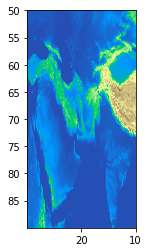

In [27]:
## Run the raster merge
merged_array, merged_transform = merge(datasets)

## Copy the meta data of the last tif file read in in the cell above
out_meta = file.meta.copy()
out_meta.update({"driver": "GTiff",
                  "height": merged_array.shape[1],
                  "width": merged_array.shape[2],
                  "transform": merged_transform,
                  }
                   )

## Output to a file to be read back in
out_path = './source_data/iran_topog.tif'

with rasterio.open(out_path, "w", **out_meta) as dest:
    dest.write(merged_array)
    
topog_file = rasterio.open(out_path, 'r')
topog_data = topog_file.read()

## Plot to see it has worked
plt.imshow(topog_data[0], cmap='terrain', extent=topog_file.bounds)


In [28]:
iran = countries[countries['ADMIN'] == 'Iran']


### Clip the topography file to just Iran using the country outline

In [29]:
## First get France from the countries geojson. France returns all of France's territories so
## you have to explode the results and pick the France mainland (found via trial and error)
iran = countries[countries['ADMIN'] == 'Iran']

## Mask French topography using the country outline
iran_topog_array, iran_topog_transform = msk.mask(topog_file, [mapping(iran.iloc[0].geometry)], crop=True)

## Repeat setting anywhere with no-data to be 1m above the max topography. We will use this when we build the 
## colour map to set it to the right background colour

iran_topog_array, iran_topog_transform = msk.mask(topog_file, [mapping(iran.iloc[0].geometry)], crop=True, 
                    nodata=-200)

## Write out and read back in. This makes it easier to work with when plotting

iran_topog_out_path = '/Users/davidsykes/Downloads/iran_topog.tif'


iran_out_meta = topog_file.meta.copy()
iran_out_meta.update({"driver": "GTiff",
                  "height": iran_topog_array.shape[1],
                  "width": iran_topog_array.shape[2],
                  "transform": iran_topog_transform,
                  }
                   )


with rasterio.open(iran_topog_out_path, "w", **iran_out_meta) as dest:
    dest.write(iran_topog_array)
    
iran_topog_file = rasterio.open(iran_topog_out_path, 'r')
iran_topog_data = iran_topog_file.read()

iran_topog_file.bounds


BoundingBox(left=44.01444444444444, bottom=25.058194444444442, right=63.32069444444444, top=39.772777777777776)

In [38]:
iran_topog_data[0]

array([[-200, -200, -200, ..., -200, -200, -200],
       [-200, -200, -200, ..., -200, -200, -200],
       [-200, -200, -200, ..., -200, -200, -200],
       ...,
       [-200, -200, -200, ..., -200, -200, -200],
       [-200, -200, -200, ..., -200, -200, -200],
       [-200, -200, -200, ..., -200, -200, -200]], dtype=int16)

### Calculate hillshade

In [31]:
hillshade = es.hillshade(iran_topog_data[0], azimuth=45, altitude=0)
hillshade[iran_topog_data[0] == -200] = np.NaN


### Plot using imshow and calculated hillshade 

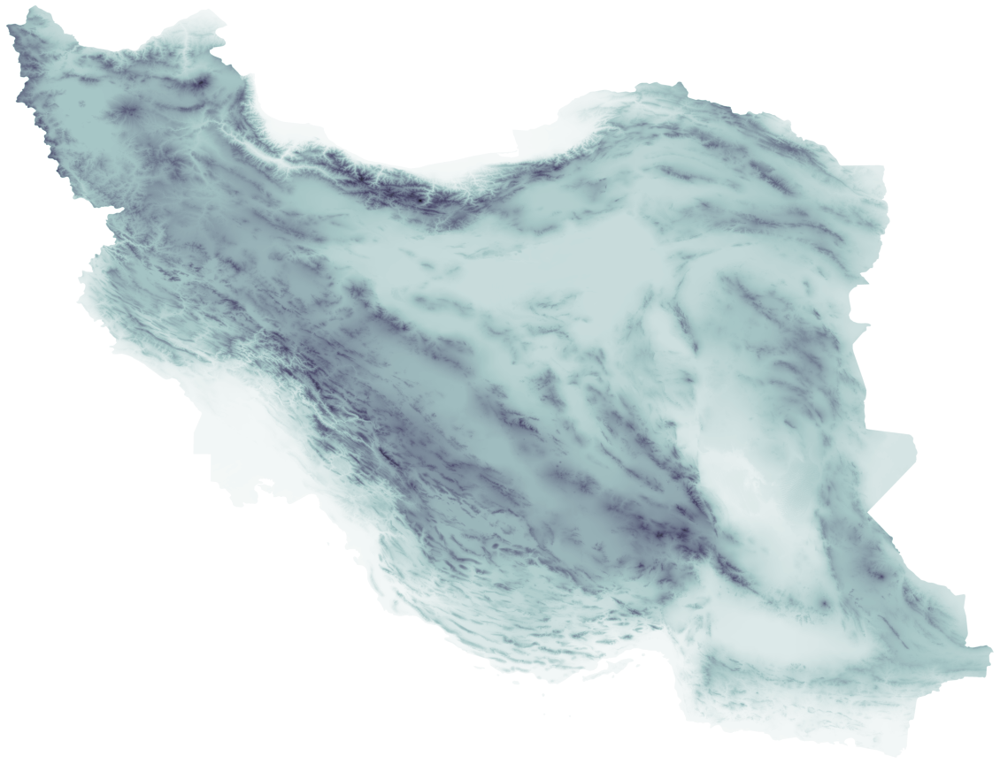

In [32]:
fig, ax = plt.subplots(1, figsize=(20,20))

## Plot the topography data (using the bounds from the file itself)
ax.imshow(iran_topog_data[0], extent=(iran_topog_file.bounds.left, 
                                        iran_topog_file.bounds.right,
                                        iran_topog_file.bounds.bottom,
                                        iran_topog_file.bounds.top), cmap='bone_r', alpha=1)

iran.plot(edgecolor='none', facecolor='none', lw=1, ax=ax)

ax.imshow(hillshade, extent=(iran_topog_file.bounds.left, 
                                        iran_topog_file.bounds.right,
                                        iran_topog_file.bounds.bottom,
                                        iran_topog_file.bounds.top), cmap="bone", alpha=0)


#Remove axes and set legend and margins
ax.axes.xaxis.set_visible(False)
ax.axes.yaxis.set_visible(False)
ax.margins(x=0)
ax.margins(y=0)
fig.patch.set_visible(False)
ax.axis('off')


plt.savefig('/Users/davidsykes/Downloads/iran_map_2.png')


### Plot using the matplotlib lightsource

https://matplotlib.org/stable/gallery/specialty_plots/topographic_hillshading.html#sphx-glr-gallery-specialty-plots-topographic-hillshading-py

In [37]:
fig, ax = plt.subplots(1, figsize=(100,100))

ls = LightSource(azdeg=315, altdeg=45)

rgb = ls.shade(iran_topog_data[0], cmap=cm.bone_r, blend_mode='overlay',
                       vert_exag=10)

## Plot the topography data (using the bounds from the file itself)
ax.imshow(rgb, extent=(iran_topog_file.bounds.left, 
                                        iran_topog_file.bounds.right,
                                        iran_topog_file.bounds.bottom,
                                        iran_topog_file.bounds.top), cmap='bone_r', alpha=1)

iran.plot(edgecolor='none', facecolor='none', lw=1, ax=ax)



#Remove axes and set legend and margins
ax.axes.xaxis.set_visible(False)
ax.axes.yaxis.set_visible(False)
ax.margins(x=0)
ax.margins(y=0)
fig.patch.set_visible(False)
ax.axis('off')


plt.savefig('/Users/davidsykes/Downloads/iran_map_2.png')